# Voice conversion prototyping

with GMMs; Arctic corpus

In [1]:
# open data
from os.path import join, expanduser
DATA_ROOT = join(expanduser("~"), "Documents/em_lct/UoM/thesis/data/", "arctic")
!ls $DATA_ROOT

cmu_us_awb_arctic cmu_us_clb_arctic


In [2]:
# nnmnkwii imports taken from example notebook on VC
%pylab inline
rcParams["figure.figsize"] = (16,5)

from nnmnkwii.datasets import PaddedFileSourceDataset
from nnmnkwii.datasets.cmu_arctic import CMUArcticWavFileDataSource
from nnmnkwii.preprocessing.alignment import DTWAligner
from nnmnkwii.preprocessing import trim_zeros_frames, remove_zeros_frames, delta_features
from nnmnkwii.util import apply_each2d_trim
from nnmnkwii.metrics import melcd
from nnmnkwii.baseline.gmm import MLPG

from os import listdir
from os.path import basename, splitext, join, splitext, isdir
import sys
import time

import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy import signal
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import pyworld
import pysptk
from pysptk.synthesis import MLSADF, Synthesizer
import librosa
import librosa.display
import IPython
from IPython.display import Audio

Populating the interactive namespace from numpy and matplotlib


/Users/kennylino/.local/share/virtualenvs/thesis-W2ZHkp3l/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)


In [3]:
fs = 16000
fftlen = pyworld.get_cheaptrick_fft_size(fs)
alpha = pysptk.util.mcepalpha(fs)
order = 24
frame_period = 5
hop_length = int(fs * (frame_period * 0.001))
max_files = 150 # number of utterances to be used.
test_size = 0.33
use_delta = True

if use_delta:
    windows = [
        (0, 0, np.array([1.0])),
        (1, 1, np.array([-0.5, 0.0, 0.5])),
        (1, 1, np.array([1.0, -2.0, 1.0])),
    ]
else:
    windows = [
        (0, 0, np.array([1.0])),
    ]

In [4]:
class MyFileDataSource(CMUArcticWavFileDataSource):
    def __init__(self, *args, **kwargs):
        super(MyFileDataSource, self).__init__(*args, **kwargs)
        self.test_paths = None

    def collect_files(self):
        paths = super(
            MyFileDataSource, self).collect_files()
        paths_train, paths_test = train_test_split(
            paths, test_size=test_size, random_state=42)

        # keep paths for later testing
        self.test_paths = paths_test

        return paths_train

    def collect_features(self, path):
        x, frame_sample = librosa.load(path, sr=fs, dtype=float64)
        f0, timeaxis = pyworld.dio(x, frame_sample, frame_period=frame_period)
        f0 = pyworld.stonemask(x, f0, timeaxis, frame_sample)
        spectrogram = pyworld.cheaptrick(x, f0, timeaxis, frame_sample)
        spectrogram = trim_zeros_frames(spectrogram)
        mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
        return mc

In [5]:
src_speaker = MyFileDataSource(data_root=DATA_ROOT, speakers=["clb"], max_files=max_files)
tgt_speaker = MyFileDataSource(data_root=DATA_ROOT, speakers=["awb"], max_files=max_files)  # This is actually speaker TNI from Arctic L2 

In [6]:
# convert training sets into arrays
X = PaddedFileSourceDataset(src_speaker, 1200).asarray()
Y = PaddedFileSourceDataset(tgt_speaker, 1200).asarray()
print(X.shape)
print(Y.shape) 
# shape = (13 training audios, 2800 frames, 25 features per frame)

(100, 1200, 25)
(100, 1200, 25)


In [7]:
src_speaker.test_paths

['/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0074.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0019.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0119.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0079.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0077.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0032.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0065.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0142.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0069.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_clb_arctic/wav/arctic_a0083.wav',


In [8]:
tgt_speaker.test_paths

['/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0074.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0019.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0119.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0079.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0077.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0032.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0065.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0142.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0069.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/arctic/cmu_us_awb_arctic/wav/arctic_a0083.wav',


In [9]:
# Plotting util
def plot_parallel(x,y):
    figure(figsize=(16,7))
    subplot(2,1,1)
    librosa.display.specshow(trim_zeros_frames(x).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()
    subplot(2,1,2)
    librosa.display.specshow(trim_zeros_frames(y).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()

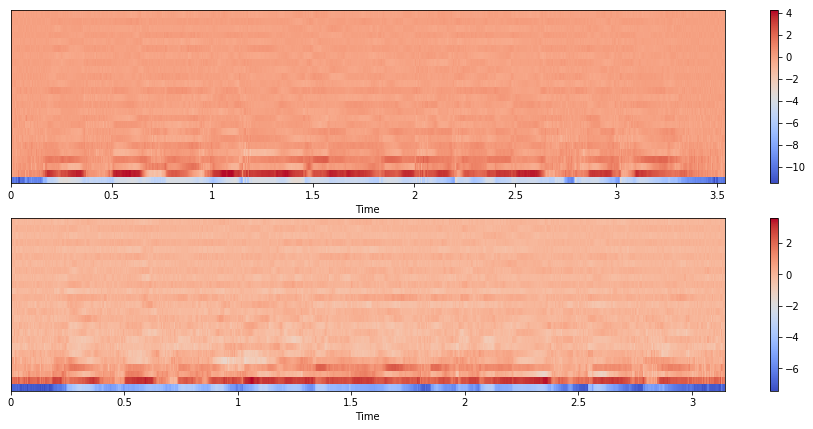

In [10]:
idx = 6 # any 
plot_parallel(X[idx],Y[idx])

In [11]:
# Alignment
X_aligned, Y_aligned = DTWAligner(verbose=0, dist=melcd).transform((X, Y))

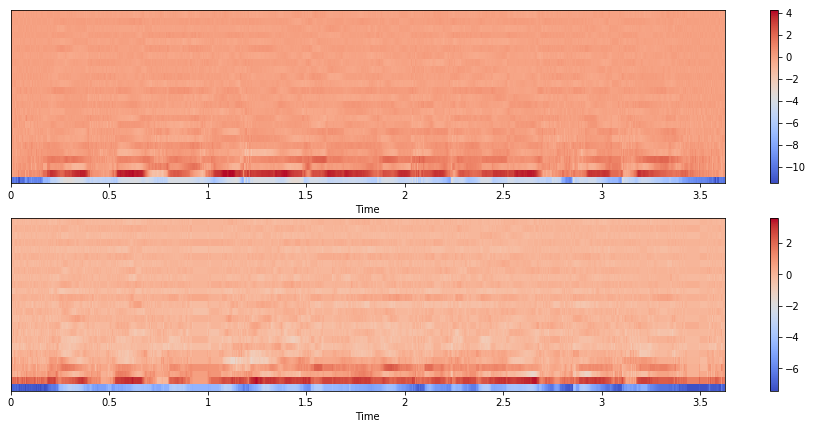

In [12]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

In [13]:
# Drop 1st (power) dimension
X_aligned, Y_aligned = X_aligned[:, :, 1:], Y_aligned[:, :, 1:]

In [14]:
static_dim = X_aligned.shape[-1]
if use_delta:
    X_aligned = apply_each2d_trim(delta_features, X_aligned, windows)
    Y_aligned = apply_each2d_trim(delta_features, Y_aligned, windows)

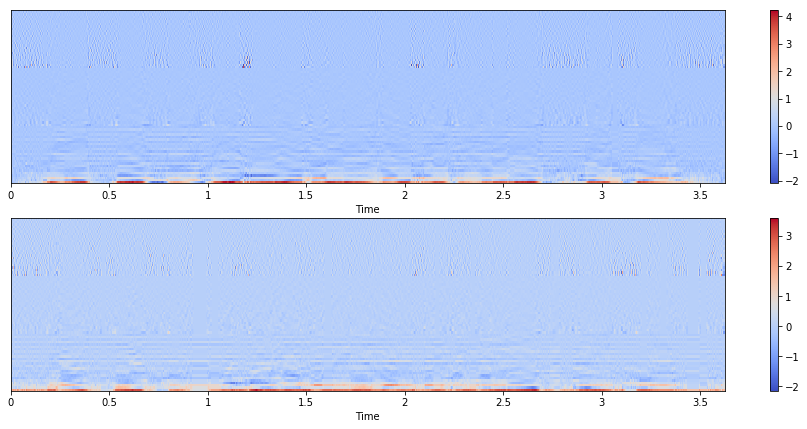

In [15]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

## Kmeans clustering of MFCC feature vectors

### clustering of source speaker

In [16]:
km_X = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [17]:
X_aligned.shape

(100, 1280, 72)

In [18]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_X = numpy.concatenate(X_aligned, axis=0)

In [19]:
# should equal number of frames * number of utterances
len(all_frames_X)

128000

In [20]:
all_frames_X.shape

(128000, 72)

In [21]:
all_frames_X[0]

array([-0.08512677,  0.32886109, -0.04306604,  0.00885858, -0.07071689,
       -0.05170614, -0.3341952 ,  0.20725627,  0.25745872, -0.10128701,
       -0.15383081,  0.19750619, -0.1352911 , -0.04796693,  0.1206748 ,
       -0.00782359, -0.09705974,  0.12053207, -0.06792336,  0.03815919,
       -0.05146481,  0.0653097 , -0.07866587,  0.07901587,  0.1497291 ,
        0.07857811,  0.12696892,  0.03550215,  0.02640928, -0.00553269,
       -0.04340923, -0.01911761,  0.03833678, -0.02156752,  0.02678536,
       -0.03780977,  0.02204646, -0.0213897 ,  0.00500086,  0.02415269,
       -0.03621148,  0.01939849, -0.00914758,  0.0133611 , -0.01362466,
        0.01135311,  0.00073545, -0.01663599,  0.46971172, -0.50056595,
        0.34006992,  0.05328713,  0.19425233,  0.0923469 ,  0.58157194,
       -0.45274776, -0.43824387,  0.15943898,  0.36123234, -0.47063193,
        0.31467512,  0.05315448, -0.23134789,  0.06395257,  0.12169652,
       -0.20226716,  0.11755155, -0.04959617,  0.07568031, -0.10

In [22]:
# 0 frames are removed since they are all exactly the same
all_frames_X = remove_zeros_frames(all_frames_X)

In [23]:
len(all_frames_X)

77532

In [24]:
%time
km_X.fit(all_frames_X)

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 6.91 µs


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [25]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_X = pd.DataFrame()
clustered_X['frame'] = all_frames_X.tolist()
clustered_X['cluster #'] = km_X.labels_

In [26]:
clustered_X.head()

,frame,cluster #
0,"[-0.08512676507234573, 0.3288610875606537, -0....",101
1,"[0.29945820569992065, 0.15715622901916504, 0.2...",139
2,"[-0.11142698675394058, -0.229370579123497, -0....",71
3,"[-0.1758842021226883, 0.13242444396018982, 0.1...",254
4,"[-0.11420781910419464, -0.02520756423473358, 0...",433


In [27]:
cluster_dist_X = clustered_X.groupby('cluster #').size()

In [28]:
# use print(cluster_dist_X.to_string()) to see whole dist
print (cluster_dist_X.head)

<bound method NDFrame.head of cluster #
0      251
1      200
2      136
3      119
4       31
5      107
6      109
7      167
8      263
9      108
10     222
11     152
12     227
13     190
14     297
15      83
16     187
17      81
18     385
19     172
20     180
21     387
22      32
23      37
24     134
25     236
26     307
27     120
28     110
29      85
      ... 
482    161
483    262
484    234
485     70
486    108
487     96
488     98
489     23
490    105
491    306
492    113
493     85
494     79
495     85
496    111
497     60
498     98
499     65
500    179
501    307
502    132
503     79
504    125
505     83
506     85
507     95
508     70
509    105
510    109
511     85
Length: 512, dtype: int64>


In [29]:
cluster_dist_X.describe()

count    512.000000
mean     151.429688
std       88.451557
min        9.000000
25%       88.000000
50%      121.000000
75%      207.250000
max      502.000000
dtype: float64

### Clustering of the target speaker data

In [30]:
km_Y = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [31]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_Y = numpy.concatenate(Y_aligned, axis=0)

In [32]:
# should equal number of frames * number of utterances
len(all_frames_Y)

128000

In [33]:
all_frames_Y.shape

(128000, 72)

In [34]:
test = all_frames_Y[0]

In [35]:
# 0 frames are removed since they are all exactly the same
all_frames_Y = remove_zeros_frames(all_frames_Y)

In [36]:
%time
km_Y.fit(all_frames_Y)

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 7.15 µs


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [37]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_Y = pd.DataFrame()
clustered_Y['frame'] = all_frames_Y.tolist()
clustered_Y['cluster #'] = km_Y.labels_

In [38]:
clustered_Y.head()

,frame,cluster #
0,"[1.9590089321136475, 0.918249249458313, 0.3208...",261
1,"[2.008671760559082, 0.7578003406524658, 0.7481...",268
2,"[1.7209007740020752, 0.45246070623397827, 0.36...",84
3,"[1.613074541091919, 0.55586838722229, 0.101260...",350
4,"[1.8119364976882935, 0.3972678482532501, 0.533...",169


In [39]:
cluster_dist_Y = clustered_Y.groupby('cluster #').size()

In [40]:
# use print(cluster_dist_Y.to_string()) to see whole dist
print (cluster_dist_Y.head)

<bound method NDFrame.head of cluster #
0      128
1      256
2      302
3      234
4       99
5      109
6      258
7      149
8      339
9      147
10     141
11     205
12      53
13     128
14     242
15     210
16     176
17     147
18     172
19     120
20     183
21     118
22     151
23     181
24     289
25      35
26     231
27     153
28     128
29     278
      ... 
482    113
483    103
484    241
485     20
486    177
487    238
488     34
489     55
490     62
491    156
492    316
493     76
494    214
495    230
496     96
497    114
498    132
499    103
500    133
501    142
502    137
503    222
504     80
505    106
506    118
507    130
508    227
509    107
510     90
511    119
Length: 512, dtype: int64>


In [41]:
cluster_dist_Y.describe()

count    512.000000
mean     151.429688
std       77.858111
min       18.000000
25%       99.000000
50%      128.000000
75%      203.000000
max      416.000000
dtype: float64

### Building the look-up table

In [42]:
%%time
# shape = (13 training audios, 2800 frames, 25 features per frame)

# all_frames_x contains each frame from each audio inside of X (aka X_aligned)

# the psuedocode for finding closest frames 
# for frame in all_frames_X:
#    predict the cluster of the frame in clustered_Y
#    find the closest data point in clustered_Y to frame
#    store X_frame and most similar frame, Y_frame in paired_frames_X

from scipy import spatial

# bytes version of X: array from Y
paired_frames_X = {}

for frame in all_frames_X:
    # needs to be reshaped to shape of km training data 
    frame_pred = frame.reshape(1, -1)
    predicted_cluster = km_Y.predict(frame_pred)[0] # returns cluster num
    # grabs the possible frames and converts them to the proper array format for KDTree
    possible_frames = (clustered_Y[clustered_Y['cluster #'] == predicted_cluster]['frame'].values).tolist()
    tree = spatial.KDTree(possible_frames)
    # tree.query() returns (the distance between the closest frame and index in series)
    most_similar = tree.query(frame)
    most_similar_vec = np.array(possible_frames[most_similar[1]]) # index in possible_frames
    frame_key = frame.tobytes() # converted to bytes since arrays cannot be keys
    paired_frames_X[frame_key] = most_similar_vec  

CPU times: user 25min 45s, sys: 5min 7s, total: 30min 53s
Wall time: 7min 51s


In [43]:
# creates the 'most similar to X' array
Y = np.array([paired_frames_X[frame.tobytes()] for frame in all_frames_X])

In [44]:
XY = np.concatenate((all_frames_X, Y), axis=-1)
print(XY.shape)

(77532, 144)


## GMM training

In [45]:
# trains the GMM between the L1 and L2 speaker
gmm = GaussianMixture(
    n_components=64, covariance_type="full", max_iter=100, verbose=1)

%time gmm.fit(XY)

Initialization 0
  Iteration 0
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
  Iteration 70
  Iteration 80
  Iteration 90
Initialization converged: False
CPU times: user 1h 53min 58s, sys: 17min 43s, total: 2h 11min 42s
Wall time: 33min 42s


/Users/kennylino/.local/share/virtualenvs/thesis-W2ZHkp3l/lib/python3.6/site-packages/sklearn/mixture/base.py:237: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  % (init + 1), ConvergenceWarning)


GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=64, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=1,
        verbose_interval=10, warm_start=False, weights_init=None)

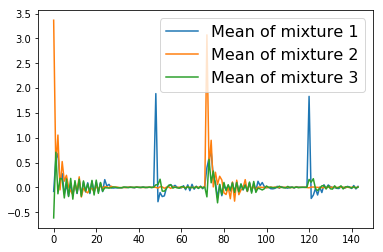

In [46]:
for k in range(3):
    plot(gmm.means_[k], linewidth=1.5, label="Mean of mixture {}".format(k+1))
legend(prop={"size": 16})

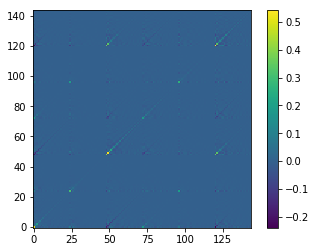

In [47]:
imshow(gmm.covariances_[0], origin="bottom left")
colorbar()

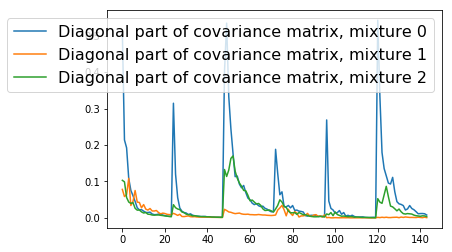

In [48]:
for k in range(3):
    plot(np.diag(gmm.covariances_[k]), linewidth=1.5, 
         label="Diagonal part of covariance matrix, mixture {}".format(k))
legend(prop={"size": 16})

In [49]:
def test_one_utt(src_path, tgt_path, disable_mlpg=False, diffvc=True):
    # GMM-based parameter generation is provided by the library in `baseline` module
    if disable_mlpg:
        # Force disable MLPG
        paramgen = MLPG(gmm, windows=[(0,0, np.array([1.0]))], diff=diffvc)
    else:
        paramgen = MLPG(gmm, windows=windows, diff=diffvc)

    x, frame_sample = librosa.load(src_path, sr=fs, dtype=float64)
    f0, timeaxis = pyworld.dio(x, frame_sample, frame_period=frame_period)
    f0 = pyworld.stonemask(x, f0, timeaxis, frame_sample)
    spectrogram = pyworld.cheaptrick(x, f0, timeaxis, frame_sample)
    aperiodicity = pyworld.d4c(x, f0, timeaxis, frame_sample)

    mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
    c0, mc = mc[:, 0], mc[:, 1:]
    if use_delta:
        mc = delta_features(mc, windows)
    mc = paramgen.transform(mc)
    if disable_mlpg and mc.shape[-1] != static_dim:
        mc = mc[:,:static_dim]
    assert mc.shape[-1] == static_dim
    mc = np.hstack((c0[:, None], mc))
    if diffvc:
        mc[:, 0] = 0 # remove power coefficients
        engine = Synthesizer(MLSADF(order=order, alpha=alpha), hopsize=hop_length)
        b = pysptk.mc2b(mc.astype(np.float64), alpha=alpha)
        waveform = engine.synthesis(x, b)
    else:
        spectrogram = pysptk.mc2sp(
            mc.astype(np.float64), alpha=alpha, fftlen=fftlen)
        waveform = pyworld.synthesize(
            f0, spectrogram, aperiodicity, frame_sample, frame_period)
        
    return waveform

Compare results with [this](http://people.tamu.edu/~guanlong.zhao/icassp18_demo.html)

In [50]:
for i, (src_path, tgt_path) in enumerate(zip(src_speaker.test_paths, tgt_speaker.test_paths)):
    print("{}-th sample".format(i+1))
    wo_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=True)
    w_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=False)
    src, _ = librosa.load(src_path, sr=fs, dtype=float64)
    tgt, _ = librosa.load(tgt_path, sr=fs, dtype=float64)
    
    print("Source:", basename(src_path))
    IPython.display.display(Audio(src, rate=fs))
    print("Target:", basename(tgt_path))
    IPython.display.display(Audio(tgt, rate=fs))
    print("w/o MLPG")
    IPython.display.display(Audio(wo_MLPG, rate=fs))
    print("w/ MLPG")
    IPython.display.display(Audio(w_MLPG, rate=fs))

1-th sample
Source: arctic_a0074.wav


Target: arctic_a0074.wav


w/o MLPG


w/ MLPG


2-th sample
Source: arctic_a0019.wav


Target: arctic_a0019.wav


w/o MLPG


w/ MLPG


3-th sample
Source: arctic_a0119.wav


Target: arctic_a0119.wav


w/o MLPG


w/ MLPG


4-th sample
Source: arctic_a0079.wav


Target: arctic_a0079.wav


w/o MLPG


w/ MLPG


5-th sample
Source: arctic_a0077.wav


Target: arctic_a0077.wav


w/o MLPG


w/ MLPG


6-th sample
Source: arctic_a0032.wav


Target: arctic_a0032.wav


w/o MLPG


w/ MLPG


7-th sample
Source: arctic_a0065.wav


Target: arctic_a0065.wav


w/o MLPG


w/ MLPG


8-th sample
Source: arctic_a0142.wav


Target: arctic_a0142.wav


w/o MLPG


w/ MLPG


9-th sample
Source: arctic_a0069.wav


Target: arctic_a0069.wav


w/o MLPG


w/ MLPG


10-th sample
Source: arctic_a0083.wav


Target: arctic_a0083.wav


w/o MLPG


w/ MLPG


11-th sample
Source: arctic_a0111.wav


Target: arctic_a0111.wav


w/o MLPG


w/ MLPG


12-th sample
Source: arctic_a0013.wav


Target: arctic_a0013.wav


w/o MLPG


w/ MLPG


13-th sample
Source: arctic_a0037.wav


Target: arctic_a0037.wav


w/o MLPG


w/ MLPG


14-th sample
Source: arctic_a0010.wav


Target: arctic_a0010.wav


w/o MLPG


w/ MLPG


15-th sample
Source: arctic_a0020.wav


Target: arctic_a0020.wav


w/o MLPG


w/ MLPG


16-th sample
Source: arctic_a0057.wav


Target: arctic_a0057.wav


w/o MLPG


w/ MLPG


17-th sample
Source: arctic_a0105.wav


Target: arctic_a0105.wav


w/o MLPG


w/ MLPG


18-th sample
Source: arctic_a0070.wav


Target: arctic_a0070.wav


w/o MLPG


w/ MLPG


19-th sample
Source: arctic_a0056.wav


Target: arctic_a0056.wav


w/o MLPG


w/ MLPG


20-th sample
Source: arctic_a0133.wav


Target: arctic_a0133.wav


w/o MLPG


w/ MLPG


21-th sample
Source: arctic_a0030.wav


Target: arctic_a0030.wav


w/o MLPG


w/ MLPG


22-th sample
Source: arctic_a0128.wav


Target: arctic_a0128.wav


w/o MLPG


w/ MLPG


23-th sample
Source: arctic_a0027.wav


Target: arctic_a0027.wav


w/o MLPG


w/ MLPG


24-th sample
Source: arctic_a0129.wav


Target: arctic_a0129.wav


w/o MLPG


w/ MLPG


25-th sample
Source: arctic_a0132.wav


Target: arctic_a0132.wav


w/o MLPG


w/ MLPG


26-th sample
Source: arctic_a0146.wav


Target: arctic_a0146.wav


w/o MLPG


w/ MLPG


27-th sample
Source: arctic_a0109.wav


Target: arctic_a0109.wav


w/o MLPG


w/ MLPG


28-th sample
Source: arctic_a0144.wav


Target: arctic_a0144.wav


w/o MLPG


w/ MLPG


29-th sample
Source: arctic_a0046.wav


Target: arctic_a0046.wav


w/o MLPG


w/ MLPG


30-th sample
Source: arctic_a0031.wav


Target: arctic_a0031.wav


w/o MLPG


w/ MLPG


31-th sample
Source: arctic_a0023.wav


Target: arctic_a0023.wav


w/o MLPG


w/ MLPG


32-th sample
Source: arctic_a0016.wav


Target: arctic_a0016.wav


w/o MLPG


w/ MLPG


33-th sample
Source: arctic_a0066.wav


Target: arctic_a0066.wav


w/o MLPG


w/ MLPG


34-th sample
Source: arctic_a0012.wav


Target: arctic_a0012.wav


w/o MLPG


w/ MLPG


35-th sample
Source: arctic_a0043.wav


Target: arctic_a0043.wav


w/o MLPG


w/ MLPG


36-th sample
Source: arctic_a0147.wav


Target: arctic_a0147.wav


w/o MLPG


w/ MLPG


37-th sample
Source: arctic_a0052.wav


Target: arctic_a0052.wav


w/o MLPG


w/ MLPG


38-th sample
Source: arctic_a0028.wav


Target: arctic_a0028.wav


w/o MLPG


w/ MLPG


39-th sample
Source: arctic_a0005.wav


Target: arctic_a0005.wav


w/o MLPG


w/ MLPG


40-th sample
Source: arctic_a0033.wav


Target: arctic_a0033.wav


w/o MLPG


w/ MLPG


41-th sample
Source: arctic_a0143.wav


Target: arctic_a0143.wav


w/o MLPG


w/ MLPG


42-th sample
Source: arctic_a0086.wav


Target: arctic_a0086.wav


w/o MLPG


w/ MLPG


43-th sample
Source: arctic_a0087.wav


Target: arctic_a0087.wav


w/o MLPG


w/ MLPG


44-th sample
Source: arctic_a0017.wav


Target: arctic_a0017.wav


w/o MLPG


w/ MLPG


45-th sample
Source: arctic_a0011.wav


Target: arctic_a0011.wav


w/o MLPG


w/ MLPG


46-th sample
Source: arctic_a0082.wav


Target: arctic_a0082.wav


w/o MLPG


w/ MLPG


47-th sample
Source: arctic_a0134.wav


Target: arctic_a0134.wav


w/o MLPG


w/ MLPG


48-th sample
Source: arctic_a0138.wav


Target: arctic_a0138.wav


w/o MLPG


w/ MLPG


49-th sample
Source: arctic_a0076.wav


Target: arctic_a0076.wav


w/o MLPG


w/ MLPG


50-th sample
Source: arctic_a0110.wav


Target: arctic_a0110.wav


w/o MLPG


w/ MLPG
